In [1]:
import MDAnalysis as mda
import numpy as np
import matplotlib.pyplot as plt
import scienceplots
plt.style.use(['science','notebook'])

/home/daneel/gitrepos/mdanalysis/package/MDAnalysis/lib/_distopia.py:45: RuntimeWarning: Install 'distopia>=0.2.0,<0.3.0' to be used with this release of MDAnalysis. Your installed version of distopia >=0.3.0 will NOT be used.
  warnings.warn(


## RMSD Calculation

In [2]:
#Read all the trajectories
colpk_pea= mda.Universe('colpk_pea_complex/sys_prod/start.pdb', 'colpk_pea_complex/sys_prod/prod_colpk_pea_complex_compact_compact.xtc')


/home/daneel/gitrepos/mdanalysis/package/MDAnalysis/topology/PDBParser.py:346: UserWarning: Unknown element  found for some atoms. These have been given an empty element record. If needed they can be guessed using universe.guess_TopologyAttrs(context='default', to_guess=['elements']).
  warnings.warn(wmsg)


  0%|          | 0/5001 [00:00<?, ?it/s]

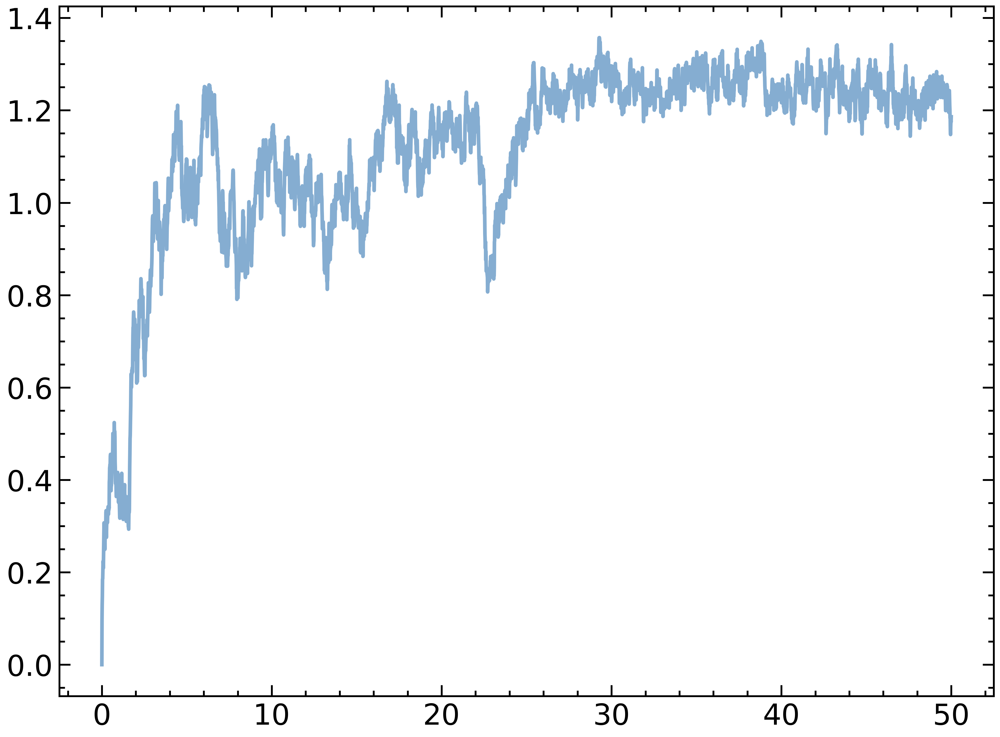

In [3]:
from MDAnalysis.analysis import rms

R = rms.RMSD(colpk_pea,  # universe to align
    colpk_pea,  # reference universe or atomgroup
    select='backbone',  # group to superimpose and calculate RMSD
    ref_frame=0)  # frame index of the reference

R.run(verbose=True)
times_c = R.results.rmsd[:,1]
rmsd_c = R.results.rmsd[:,2]
plt.plot(times_c/1000, rmsd_c/10, alpha=0.5)

## Radius of Gyration Calculation

  0%|          | 0/5001 [00:00<?, ?it/s]

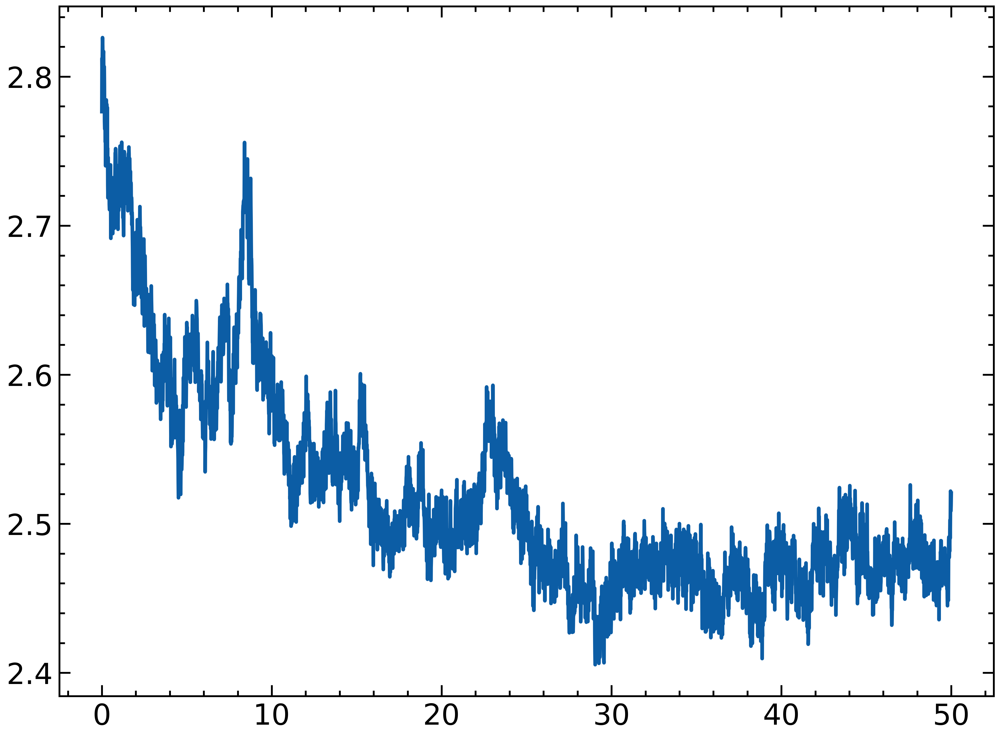

In [5]:
from tqdm.notebook import tqdm
group = colpk_pea.select_atoms('protein')		# change the atom selection for your specific system

Frame = []
times = []
Rgyr = []
for ts in tqdm(colpk_pea.trajectory):
	Frame.append(ts.frame)
	times.append(colpk_pea.trajectory.time)
	Rgyr.append(group.radius_of_gyration())

Rgyrc_table = np.vstack((Frame, times, Rgyr)).T
plt.plot(Rgyrc_table[:,1]/1000, Rgyrc_table[:,2]/10)

## RMSF Calculation

Between protein backbone and Carbon alphas.

  0%|          | 0/5001 [00:00<?, ?it/s]

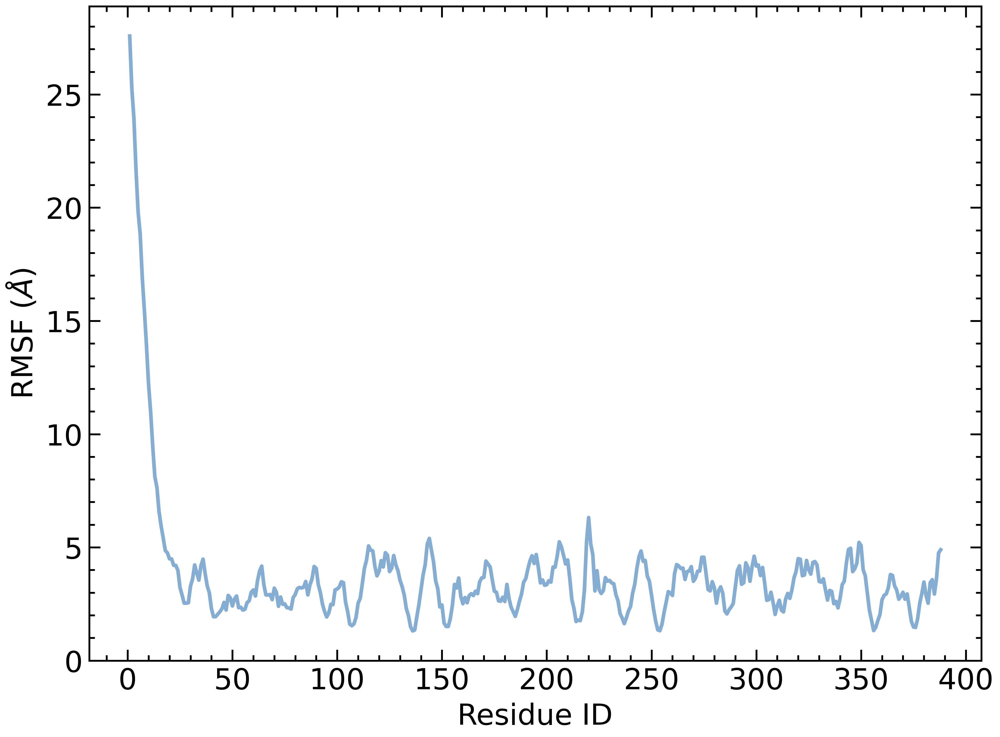

In [6]:
c_alphas_c = colpk_pea.select_atoms('backbone and name CA')
R_c = rms.RMSF(c_alphas_c).run(verbose=True)
plt.xlabel('Residue ID')
plt.ylabel(r'RMSF $\left(\AA\right)$')
plt.plot(c_alphas_c.resids, R_c.results.rmsf, alpha=0.5)
plt.savefig('rmsf.png', dpi=600)

### Observations

Unlike the other cases with Colpk and Colpm proteins, the RMSD and Rg seem to be relatively stable at the end of the sim. The RMSF still shows the tail end whipping about, though. 

## H-bond analysis:

In `MDTraj`, the Baker-Hubbard Hydrogen Bond Identification can be used, where the hydrogen bond is said to have formed if:

1. The angle $\theta_{dha}>2\pi/3$, *i.e.*, $120$ degrees, and
2. The distance $r_{ha}<0.25\;nm$. 
   
Here, $d$ means 'donor', 'h' means 'hydrogen', and 'a' means acceptor.
The donors considered by this method are NH and OH, and the acceptors considered are O and N.

Do not load the whole trajectory, as it will take up too much memory. Unlike `MDAnalysis`, `MDTraj` doesn't do lazy loads from disk, but fully operates in memory. This makes it faster, but memory-intensive.

So, we choose a 'stride' of, say, $60$ frames, and have `MDTraj` load every $60^{th}$ frame of the trajectory, then run the baker-hubbard algorithm.

Actually, it is better to load the full trajectory in hpc and pickle the results to be used locally later.

In [2]:
import numpy as np
stride = 3
total_frames = 5000
total_time_ns = 50

timestep  = (stride/total_frames) * total_time_ns

nframes = int(np.ceil(total_frames/stride))

timestep, nframes

(0.03, 1667)

In [3]:
import numpy as np
import mdtraj as md


topfile='colpk_pea_complex/sys_prod/start.pdb'
xtcfile='colpk_pea_complex/sys_prod/prod_colpk_pea_complex_compact_compact.xtc'

full_traj = md.load_xtc(xtcfile, stride=stride, top=topfile)
pea_atoms = full_traj.topology.select('resname PEA')
hbonds = md.baker_hubbard(full_traj, periodic=False, freq=0.01)
label = lambda hbond : '%s - %s ... %s' % ( full_traj.topology.atom(hbond[0]),\
                                            full_traj.topology.atom(hbond[1]),\
                                            full_traj.topology.atom(hbond[2]))
pea_hbonds = []
for hbond in hbonds:
    d,h,a = hbond
    if d in pea_atoms or a in pea_atoms:
        pea_hbonds.append(hbond)
        print(label(hbond))

pea_hbonds = np.array(pea_hbonds)


ARG96-NH1 - ARG96-HH12 ... PEA389-O1
ARG96-NH2 - ARG96-HH22 ... PEA389-O1
ASN338-ND2 - ASN338-HD21 ... PEA389-O7


So, according to `MDTraj` Baker-Hubbard hbond detector, there is **JUST ONE** hydrogen bond between protein and PYC that forms at more than a frequency of `freq=` $0.01$ in the trajectory frames. 

That bond is $22GLN-HE_{21}\cdots O_7$.

Calculate the distances and angles for each hbond.

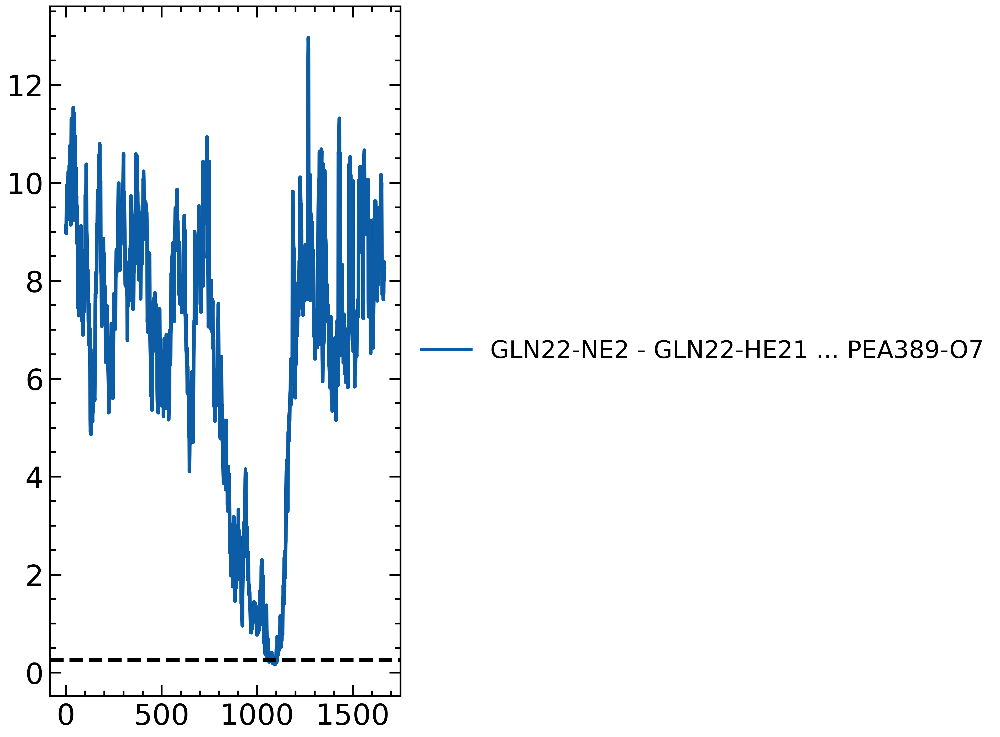

In [12]:
for hb in pea_hbonds:
    distances = md.compute_distances(full_traj, [hb[1:3]], periodic=False)
    plt.plot(distances, label=label(hb))
plt.legend(ncol=1, loc='center left', bbox_to_anchor=(1, 0.5), fontsize='small')
plt.axhline(0.25, color='black', linestyle='--')

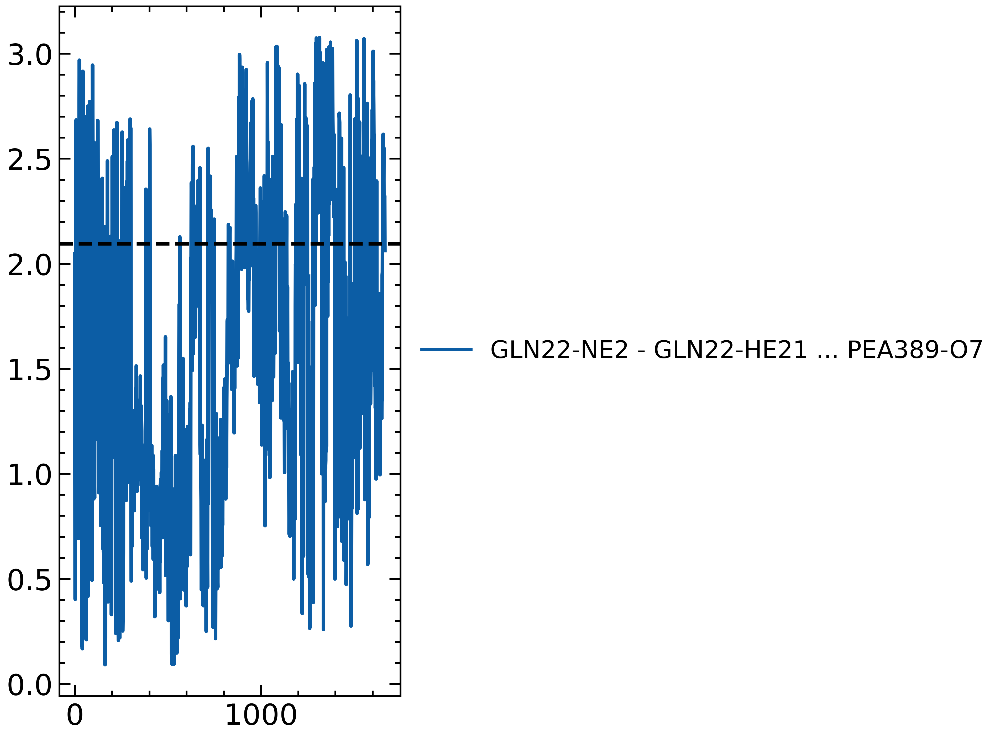

In [13]:
for hb in pea_hbonds:
    angles = md.compute_angles(full_traj, [hb], periodic=False)
    plt.plot(angles, label=label(hb))
plt.legend(ncol=1, loc='center left', bbox_to_anchor=(1, 0.5), fontsize='small')
plt.axhline(2 * np.pi/3, color='black', linestyle='--')

In [4]:
da_distances = md.compute_distances(full_traj, pea_hbonds[:, [1,2]], periodic=False)
da_angles = md.compute_angles(full_traj, pea_hbonds, periodic=False)

Let us get the number of hbonds between protein and ligand.

In [5]:
distance_met = da_distances < 0.25
angle_met = da_angles > 2 * np.pi/3
hbond_met = np.logical_and(distance_met, angle_met)
num_hbonds = np.sum(hbond_met, axis=1)

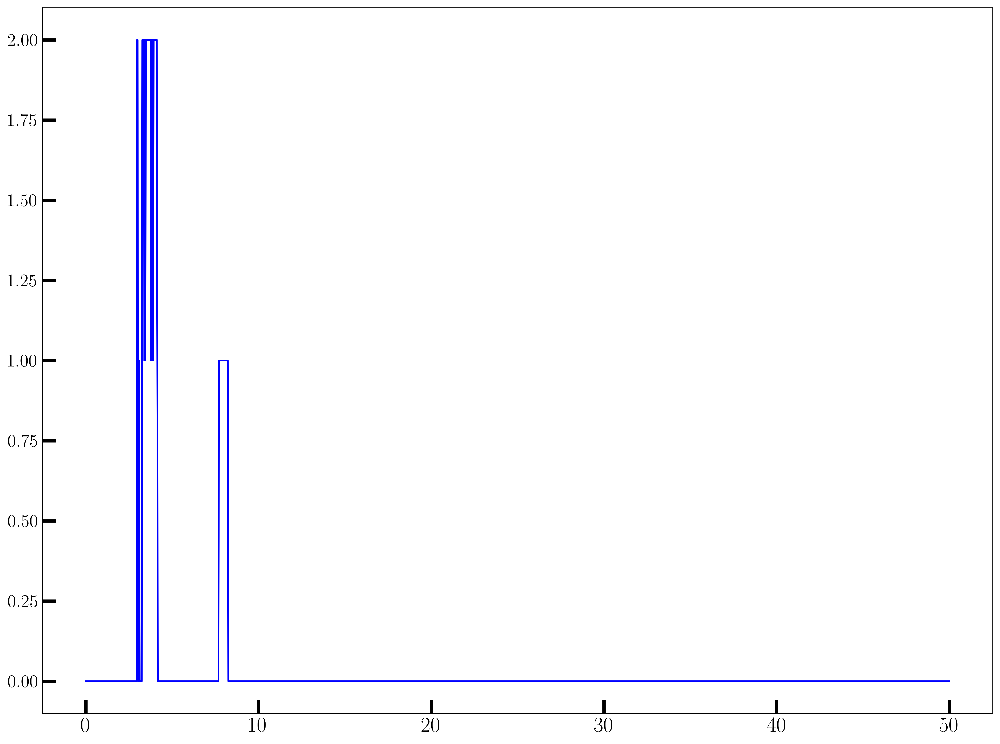

In [7]:
import matplotlib.pyplot as plt
plt.plot(full_traj.time/1000, num_hbonds,'b-')
np.savez('colpk_pea_nhb.npz', time=full_traj.time/1000, num_hbonds=num_hbonds)


The hydrogen bond is totally transient.

## Plots

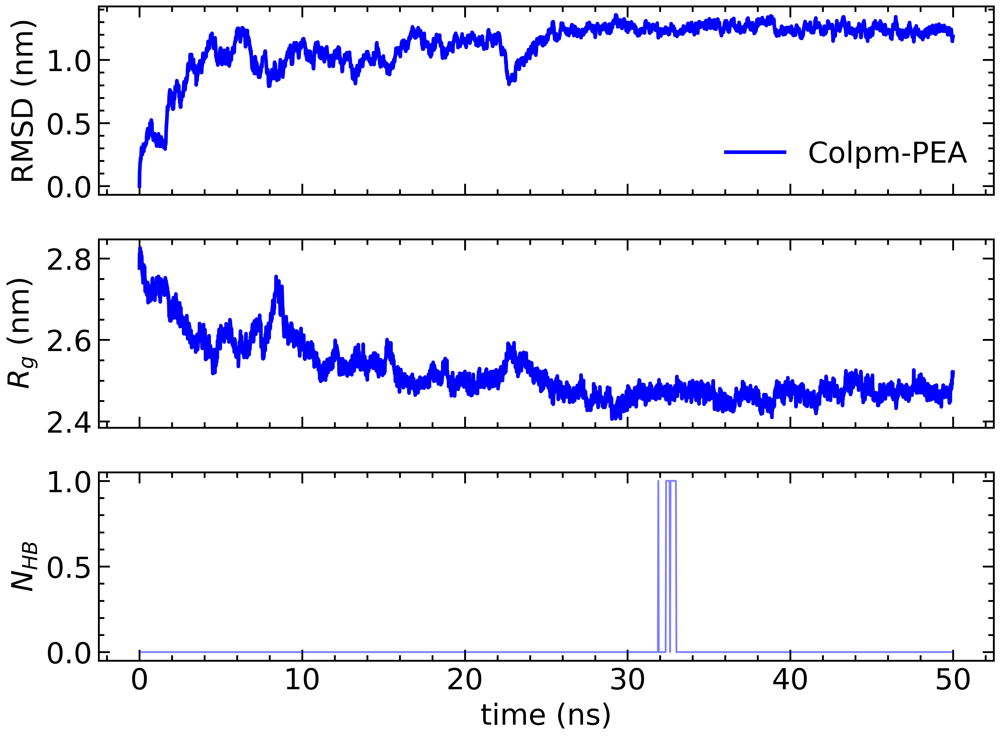

In [17]:
npanels = 3
fig, axs = plt.subplots(npanels,1, sharex=True, tight_layout=True)

ax_rmsd = axs[0]
ax_rmsd.set_ylabel(r'RMSD (nm)');


ax_rmsd.plot(times_c/1000, rmsd_c/10, label="Colpm-PEA", 
        color='blue')

ax_rmsd.legend()

ax_rg = axs[1]

ax_rg.plot(Rgyrc_table[:,1]/1000, Rgyrc_table[:,2]/10, 
        label="Colpm-PEA", color='blue')
ax_rg.set_ylabel(r'$R_g$ (nm)');

ax_bonds = axs[2]
ax_bonds.set_xlabel(r'time (ns)');

ax_bonds.plot(timestep * np.arange(nframes), num_hbonds, lw=1, label="Colpm-PEA", alpha=0.5,color='blue')


ax_bonds.set_ylabel(r"$N_{HB}$")
plt.savefig("time-series-plots.png", dpi=600)
plt.show()

## Principal Component Analysis 

We will do the PCA using `gromacs` tools. Tentative comparison yields quantitatively better results for `gromacs` than `MDAnalysis`.

***Notabene*** MUST USE BACKBONE AND LIGAND AS SELECTIONS, SINCE WE NEED TO LOOK AT LIGAND CONFORMATIONAL CHANGES AS WELL.


### PCA via GROMACS tools

Go to the `sys_prod` directory, then create an index for backbone, ligand 

`gmx make_ndx -f prod_colpk_pea_complex.gro -o prod_colpk_pea_complex_pca.ndx` Choose backbone OR PEA

Then, we need to dump the first frame of MD simulation as pdb file (unless that has already been done).

Then, generating the eigenvectors

`gmx covar -s start.pdb -f prod_colpk_pea_complex_compact_compact.xtc -o prod_colpk_pea_complex_eigenvalues.xvg -v prod_colpk_pea_complex_eigenvectors.trr -xpma prod_colpk_pea_complex_covapic.xpm -n prod_colpk_pea_complex_pca.ndx`


Selections should be the index just created.

Followed by `gmx anaeig` to generate pc1, pc2 and pc3 files

`gmx anaeig -f prod_colpk_pea_complex_compact_compact.xtc -s start.pdb -v prod_colpk_pea_complex_eigenvectors.trr -last 1 -proj prod_colpk_pea_complex_pc1.xvg -n prod_colpk_pea_complex_pca.ndx`

`gmx anaeig -f prod_colpk_pea_complex_compact_compact.xtc -s start.pdb -v prod_colpk_pea_complex_eigenvectors.trr -first 2 -last 2 -proj prod_colpk_pea_complex_pc2.xvg -n prod_colpk_pea_complex_pca.ndx`

`gmx anaeig -f prod_colpk_pea_complex_compact_compact.xtc -s start.pdb -v prod_colpk_pea_complex_eigenvectors.trr -first 3 -last 3 -proj prod_colpk_pea_complex_pc3.xvg -n prod_colpk_pea_complex_pca.ndx`


Use these three xvg files (`prod_colpk_pea_complex_pc{1,2,3}.xvg`) to generate the following plots.

In [1]:
import numpy as np

# Function to read XVG file with skip header option
def read_xvg(file_path, skip_header):
    data = []
    with open(file_path, 'r') as file:
        lines = file.readlines()
        for line in lines[skip_header:]:
            if '&' in line:
                break
            else:
                data.append([float(val) for val in line.split()])
    data = np.array(data)
    return data[:, 0], data[:, 1]

# File paths for RMSD and radius of gyration XVG files
pc1_file = 'colpk_pea_complex/sys_prod/prod_colpk_pea_complex_pc1.xvg'
pc2_file = 'colpk_pea_complex/sys_prod/prod_colpk_pea_complex_pc2.xvg'
pc3_file = 'colpk_pea_complex/sys_prod/prod_colpk_pea_complex_pc3.xvg'

# Read data from XVG files with skip headers
t1, pc1_data = read_xvg(pc1_file, skip_header=24)  # Adjust skip_header based on your file format
t2, pc2_data = read_xvg(pc2_file, skip_header=24)  # Adjust skip_header based on your file format
t2, pc3_data = read_xvg(pc3_file, skip_header=24)  # Adjust skip_header based on your file format

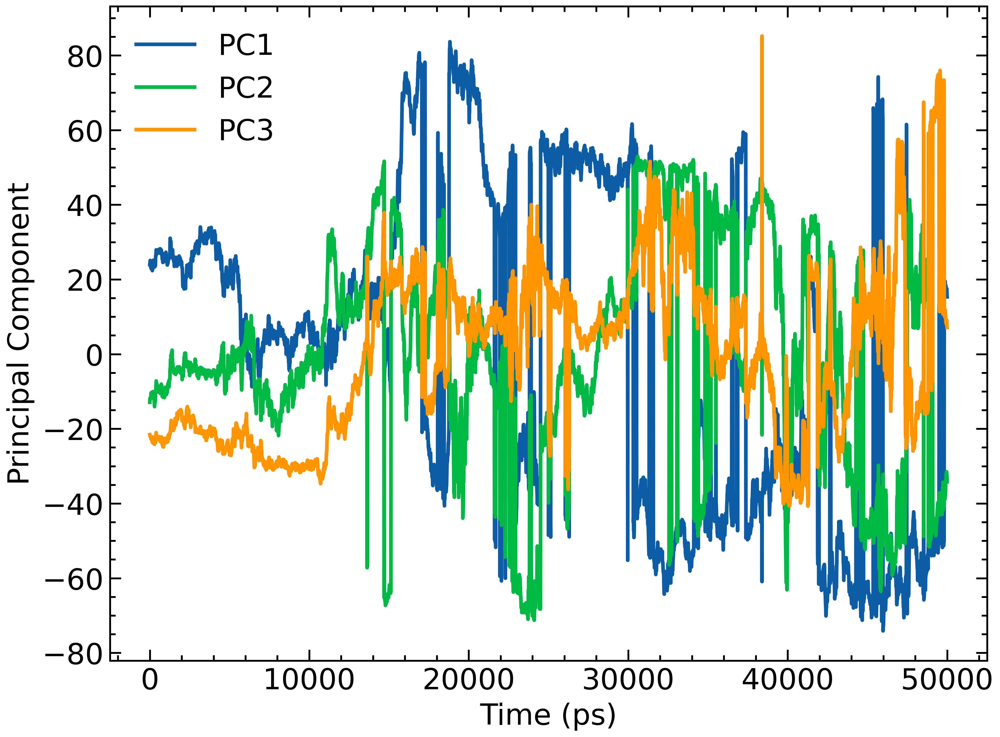

In [2]:
import matplotlib.pyplot as plt
import scienceplots
plt.style.use(['science','notebook'])
plt.plot(t1, pc1_data, label='PC1')
plt.plot(t2, pc2_data, label='PC2')
plt.plot(t2, pc3_data, label='PC3')
plt.xlabel('Time (ps)')
plt.ylabel('Principal Component')
plt.legend()

For PCA with respect to energy, first

```bash
paste prod_colpk_pea_complex_pc1.xvg prod_colpk_pea_complex_pc2.xvg | awk '{print $1, $2, $4}' > prod_colpk_pea_complex_pc1pc2.xvg

paste prod_colpk_pea_complex_pc2.xvg prod_colpk_pea_complex_pc3.xvg | awk '{print $1, $2, $4}' > prod_colpk_pea_complex_pc2pc3.xvg

paste prod_colpk_pea_complex_pc3.xvg prod_colpk_pea_complex_pc1.xvg | awk '{print $1, $2, $4}' > prod_colpk_pea_complex_pc3pc1.xvg
```

Then, use these PCIPCJ.xvg files to generate xpm files

```bash

gmx sham -f prod_colpk_pea_complex_pc1pc2.xvg -ls prod_colpk_pea_complex_FES12.xpm
gmx sham -f prod_colpk_pea_complex_pc2pc3.xvg -ls prod_colpk_pea_complex_FES23.xpm
gmx sham -f prod_colpk_pea_complex_pc3pc1.xvg -ls prod_colpk_pea_complex_FES31.xpm

```

Then use the following `xpm2txt.py` script to convert the .xpm file into .dat file:


In [ ]:
%%script true
#!/usr/bin/env python3

import sys

"""
Utility tool to convert xpm files generated by GROMACS to a 3-column text file.
"""

USAGE = "USAGE: xpm2txt.py -f <input xpm file> -o <output txt file> [-s]\n"
USAGE += "Options:\n"
USAGE += "\t-s\t(int)\tSorts the output by a given column"
USAGE += "\n"  # always keep this line

# Parse arguments
read_input, read_output, sort = False, False, False
xpm_file, out_file, column_sort = None, None, None
for arg in sys.argv[1:]:
    if read_input:
        read_input = False
        xpm_file = arg
    elif read_output:
        read_output = False
        out_file = arg
    elif sort:
        sort = False
        column_sort = int(arg)
    if arg.startswith("-"):
        if arg == "-f":
            read_input = True
            continue
        elif arg == "-o":
            read_output = True
            continue
        elif arg == "-s":
            sort = True
        else:
            print(USAGE)
            sys.stderr.write('ERROR: Option not recognized: %s\n' % arg)
            sys.exit(1)

if not xpm_file:
    print(USAGE)
    sys.stderr.write('ERROR: You forgot to provide an input file.\n')
    sys.exit(1)
if not out_file:
    out_file = "out.txt"

# Parse XPM file
with open(xpm_file) as xpm_handle:
    xpm_data = []
    x_axis, y_axis = [], []
    letter_to_value = {}
    for line in xpm_handle:
        if line.startswith("/* x-axis"):
            x_axis = list(map(float, line.split()[2:-2]))  # We trim the last value

        if line.startswith("/* y-axis"):
            y_axis = list(map(float, line.split()[2:-2]))  # We trim the last value

        if line.startswith('"') and x_axis and y_axis:  # Read data
            xpm_data.insert(0, line.strip().strip(',')[1:-1])

        if line.startswith('"') and len(line.split()) > 4:
            letter = line.split()[0][1:]
            value = float(line.split()[-2][1:-1])
            letter_to_value[letter] = value

# Match x/y/data
txt_values = []
for y_index, data_value in enumerate(xpm_data):
    y_value = y_axis[y_index]
    for x_index, x_value in enumerate(x_axis):
        txt_values.append([x_value, y_value, letter_to_value[data_value[x_index]]])

# Apply sorting if requested
if column_sort:
    try:
        txt_values.sort(key=lambda x: x[column_sort - 1])
    except IndexError:
        print(USAGE)
        sys.stderr.write('ERROR: Column not found (%s)\n' % (column_sort))
        sys.exit(1)

# Print to file
with open(out_file, 'w') as out_handle:
    for x, y, z in txt_values:
        out_handle.write("%3.5f\t%3.5f\t%3.5f\n" % (x, y, z))

Use this above-mentioned script as

```bash
./xpm2txt.py -f prod_colpk_pea_complex_FES12.xpm -o prod_colpk_pea_complex_FEL12.dat
./xpm2txt.py -f prod_colpk_pea_complex_FES23.xpm -o prod_colpk_pea_complex_FEL23.dat
./xpm2txt.py -f prod_colpk_pea_complex_FES31.xpm -o prod_colpk_pea_complex_FEL31.dat
```

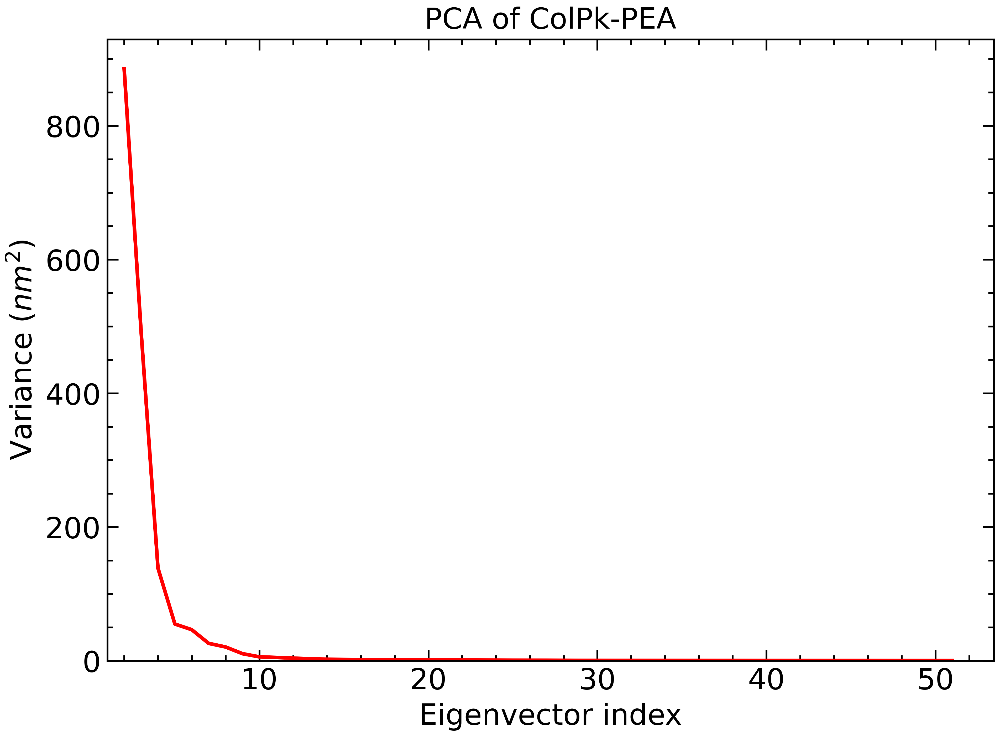

In [3]:
import matplotlib.pyplot as plt
import numpy as np

# Read input data from a file
input_file = 'colpk_pea_complex/sys_prod/prod_colpk_pea_complex_FEL12.dat'
data = np.loadtxt(input_file)  # Assuming input data file ha6s PC1, PC2, and hbonds columns

PC12_1 = data[:, 0]
PC12_2 = data[:, 1]
free_energy_12 = data[:, 2]/4.184  # Convert kJ/mol to kcal/mol


input_file = 'colpk_pea_complex/sys_prod/prod_colpk_pea_complex_FEL23.dat'
data = np.loadtxt(input_file)  # Assuming input data file ha6s PC1, PC2, and hbonds columns

PC23_2 = data[:, 0]
PC23_3 = data[:, 1]
free_energy_23 = data[:, 2]/4.184  # Convert kJ/mol to kcal/mol

input_file = 'colpk_pea_complex/sys_prod/prod_colpk_pea_complex_FEL31.dat'
data = np.loadtxt(input_file)  # Assuming input data file ha6s PC1, PC2, and hbonds columns

PC31_3 = data[:, 0]
PC31_1 = data[:, 1]
free_energy_31 = data[:, 2]/4.184  # Convert kJ/mol to kcal/mol


# Function to read XVG file and extract data
def read_xvg(file_path):
    data = np.genfromtxt(file_path, skip_header=18)  # Adjust skip_header based on your XVG file format
    xpoints = data[:, 0]
    ypoints = data[:, 1]
    return xpoints, ypoints

# Replace these placeholders with your actual file paths
D1_path = 'colpk_pea_complex/sys_prod/prod_colpk_pea_complex_eigenvalues.xvg'

# Read data from XVG files
time_D1, D1_data = read_xvg(D1_path)

plt.plot(time_D1[0:50], D1_data[0:50], color='red')
plt.xlim(1, )
plt.ylim(0, )
plt.xlabel('Eigenvector index')
plt.ylabel(r'Variance $\left(nm^2\right)$')
plt.title('PCA of ColPk-PEA');
plt.savefig("pca-colpk-pea.png", dpi=600)


In [5]:
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import scienceplots

import matplotlib.pyplot as plt

plt.style.use(['science','notebook'])
fig = plt.figure(figsize=(40, 12))
#fig.suptitle(r'PCA: Free Energy Landscapes $\left(kcal\cdot mol^{-1}\right)$', fontsize=20)
# First subplot: free_energy_12 vs PC12
ax1 = fig.add_subplot(1, 3, 1, projection='3d')
ax1.plot_trisurf(PC12_1, PC12_2, free_energy_12, cmap='viridis', alpha=0.8)
ax1.set_xlabel(r'$PC_1\; (nm)$', labelpad=20)
ax1.set_ylabel(r'$PC_2\;(nm)$', labelpad=20)
ax1.scatter(PC12_1, PC12_2, c=free_energy_12, cmap='viridis', s=50, alpha=0.5)
ax1.scatter(pc1_data[0:100], pc2_data[0:100], 0, color='magenta', linewidth=4, label='Trajectory Start')
ax1.scatter(pc1_data[-500:-1], pc2_data[-500:-1], 0, color='red', linewidth=4, label='Trajectory End')
#ax1.legend()

# Second subplot: free_energy_23 vs PC23
ax2 = fig.add_subplot(1, 3, 2, projection='3d')
ax2.plot_trisurf(PC23_2, PC23_3, free_energy_23, cmap='viridis', alpha=0.8)
ax2.set_xlabel(r'$PC_2\; (nm)$', labelpad=20)
ax2.set_ylabel(r'$PC_3\; (nm)$', labelpad=20)
ax2.scatter(PC23_2, PC23_3, c=free_energy_23, cmap='viridis', s=50, alpha=0.5)
ax2.scatter(pc2_data[0:100], pc3_data[0:100], 0, color='magenta', linewidth=4, label='Trajectory Start')
ax2.scatter(pc2_data[-500:-100], pc3_data[-500:-100], 0, color='red', linewidth=4, label='Trajectory End')

# Third subplot: free_energy_31 vs PC31
ax3 = fig.add_subplot(1, 3, 3, projection='3d')
ax3.plot_trisurf(PC31_1, PC31_3, free_energy_31, cmap='viridis', alpha=0.8)
ax3.set_xlabel(r'$PC_3\; (nm)$', labelpad=20)
ax3.set_ylabel(r'$PC_1\; (nm)$', labelpad=20)
ax3.scatter(PC31_1, PC31_3, c=free_energy_31, cmap='viridis', s=50, alpha=0.5)
ax3.scatter(pc1_data[0:200], pc3_data[0:200], 0, color='magenta', linewidth=4, label='Trajectory Start')
ax3.scatter(pc1_data[-500:-1], pc3_data[-500:-1], 0, color='red', linewidth=4, label='Trajectory End')

for ax in [ax1, ax2, ax3]:
    ax.view_init(elev=15, azim=80)
    ax.yaxis.set_tick_params(pad=10)

ax1.view_init(elev=15, azim=30)

ax1.zaxis.set_tick_params(pad=10)
ax2.set_zticklabels([])
ax3.set_zticklabels([])
plt.savefig("pca-free-energy.svg", dpi=600)
plt.tight_layout()
plt.show()

/tmp/ipykernel_181440/718731568.py:47: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.savefig("pca-free-energy.svg", dpi=600)


### PCA Conclusion 

No obvious point of equilibration here. Doesn't look like much is happening...

Finally, I ran the following commands to project the trajectory to the PCA components and then visualize them.

`gmx anaeig -f prod_colpk_pea_complex_compact_compact.xtc -s start.pdb -extr extreme_pc.pdb -first 1 -last 3 -n prod_colpk_pea_complex_pca.ndx -nframes 80 -v prod_colpk_pea_complex_eigenvectors.trr`

Then load the three pdbs of the projections along each axis into pymol and made the following observations. The image corroborates the PCA FEL plots in that the ligand shoots out of the protein and leaves.


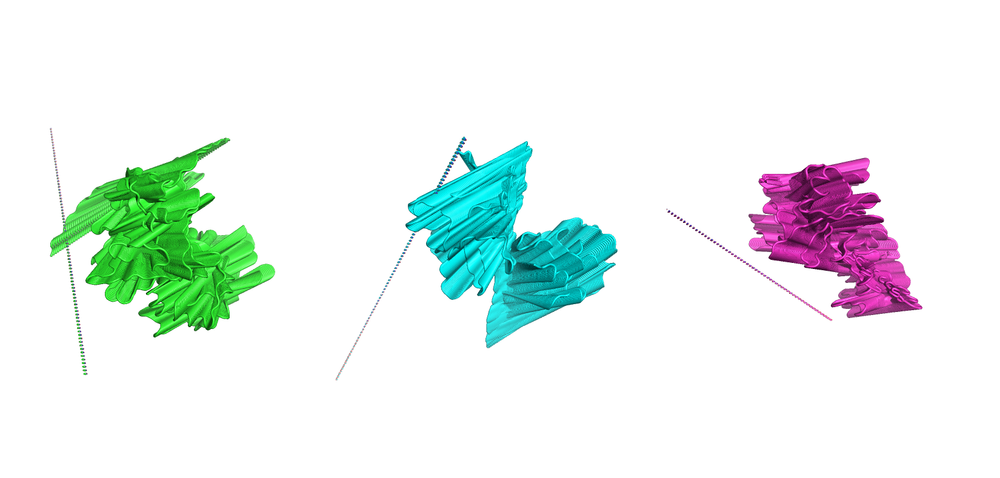

In [1]:
from IPython.display import Image
Image("pc1pc2pc3.png")

The ligand zips off from the protein, leaving no interactions.

# Important Note: 

*Date:* 20250203:0128

1. In a simulation with Colpk run so far (ligand pea), the protein and ligand separate out from the docked pose during equilibration. 
2. Not so with any of the others

## Perplexity Session:

### Query
I ran a GROMACS MD simulation between a colicin-pk protein and the ligand: phosphatedylethanolamine. I used the AMBER/GAFF2 force fields to build the topologies of both protein and ligand during the simulation. I started from the best docked pose (docked using autodock vina) and ran the  gromacs simulation workflow described here:.https://gromacs-py.readthedocs.io/en/stable/gmx_sys.html#gromacs_py.gromacs.gmx5.GmxSys.em_equi_three_step_iter_error However,, the final step (equilibration with position restraints on Carbon Alpha with Low restraints) led to the protein and the ligand separating far apart even though they started out close to each other up until now. They remained far apart throughout the 50 nanosecond MD simulation, even after equilibration. What could that mean?

### Response
The separation of your protein-ligand complex during equilibration and production MD simulations could stem from several underlying issues. Below are the most likely explanations and solutions based on GROMACS simulation principles and the provided search results:

---

### 1. **Inadequate Restraint Strategy During Equilibration**
- **Problem**: Position restraints on Cα atoms alone may fail to stabilize the ligand. If the ligand lacks restraints, solvent dynamics or weak initial interactions could displace it during equilibration[1][6][22].
- **Solution**:
  - Apply **ligand-specific restraints** during equilibration (e.g., harmonically restrain non-hydrogen atoms with `fc = 1000 kJ/mol/nm²`)[6][25].
  - Gradually reduce restraint force constants in subsequent steps (e.g., from 1000 → 500 → 100)[22].
  -**Note** We're already doing the gradual restraint thing for the protein Ca atoms. We'll have to do it to ligand also when we're doing it to proteins with `define = -DPOSRES_LIG` in the `mdp_options`.
---

### 2. **Force Field/Topology Inaccuracies**
- **Problem**: GAFF2 parameters for phosphatedylethanolamine might inadequately model interactions (e.g., charge assignment, dihedrals), destabilizing the binding pose[1][4].
- **Solution**:
  - Validate ligand topology using tools like **CGenFF** or **ATB** to check for missing parameters[1][18].
  - Compare interaction energies (Coulomb/vdW) between docked and simulated poses using `gmx energy`[37].

---

### 3. **Periodic Boundary Artifacts**
- **Problem**: Improper centering during trajectory imaging can create false separation[1][5][11].
- **Solution**:
  - Re-image the trajectory with:  
    ```bash
    gmx trjconv -f traj.xtc -s topol.tpr -o reimaged.xtc -pbc mol -center -ur compact
    ```
    Select **Protein + Ligand** as the centering group[5][24].

---

### 4. **Unstable Docking Pose**
- **Problem**: AutoDock Vina’s best pose may lack thermodynamic stability under MD conditions due to:
  - Missing solvent or entropic effects[10][34].
  - Transient interactions (e.g., weak H-bonds, hydrophobic contacts)[13][19].
- **Solution**:
  - Run **short, fully restrained simulations** (10–100 ps) to assess pose stability[13].
  - Use **enhanced sampling** (e.g., metadynamics, umbrella sampling) to explore binding/unbinding pathways[34][35].

---

### 5. **System Preparation Errors**
- **Problem**: Common setup flaws include:
  - **Small box size**: Ligand drifts due to edge effects[11][29].
  - **Incorrect pressure coupling**: Semi-isotropic/isotropic mismatches for membrane systems[26].
- **Solution**:
  - Ensure a **12–15 Å buffer** around the complex.
  - Use **Berendsen/Parrinello-Rahman barostats** with `compressibility = 4.5e-5 bar⁻¹`[6][8].

---

### 6. **Interaction Analysis**
- **Diagnostic steps**:
  - Calculate **RMSD** of ligand relative to the protein:  
    ```bash
    gmx rms -s topol.tpr -f traj.xtc -o rmsd_lig.xvg -tu ns -n index.ndx
    ```
    Select "Ligand" and "Protein" groups[37].
  - Plot **protein-ligand distance** using `gmx distance`[33][36].
  - Analyze hydrogen bonds with `gmx hbond` and hydrophobic contacts with `gmx mindist`[19][36].

---

### 7. **Advanced Refinement**
If the above steps fail:
- **Alchemical free-energy calculations** (FEP/ABF) to quantify binding affinity[30][36].
- **Targeted MD** to force rebinding and identify stabilizing interactions[10][35].

---

### Key Citations
- Restraint protocols[6][22][25]
- Force field validation[1][4]
- Trajectory imaging[5][11]
- Enhanced sampling[10][34][35]

Let me know if you need further clarification on specific steps!

### Citations:

[1] https://gromacs.bioexcel.eu/t/why-ligand-leave-the-binding-pocket-during-md-simulation/3427

[2] https://gromacs.bioexcel.eu/t/drifting-molecule-during-steered-md/2128

[3] https://gromacs.bioexcel.eu/t/issue-with-copper-ion-restraints-two-ions-moving-despite-position-restraints/7962

[4] https://gromacs.bioexcel.eu/t/ligand-structure-changed-after-nvt-equilibration/4340

[5] https://gromacs.bioexcel.eu/t/ligands-moves-far-from-the-protein/3938

[6] http://www.mdtutorials.com/gmx/complex/06_equil.html

[7] https://manual.gromacs.org/2024.2/reference-manual/functions/restraints.html

[8] https://adkgromacstutorial.readthedocs.io/en/latest/posres.html

[9] https://manual.gromacs.org/documentation/2019/user-guide/run-time-errors.html

[10] https://pubs.aip.org/aip/jcp/article/158/12/124106/2881566/Path-separation-of-dissipation-corrected-targeted

[11] https://gromacs.bioexcel.eu/t/simulation-breaks-the-system-separates-both-the-chains-of-the-antibody/5601

[12] https://www.researchgate.net/post/Why-ligands-leave-the-binding-pocket-while-running-MD-simulation

[13] https://www.nature.com/articles/s42003-022-03416-7

[14] https://www.researchgate.net/post/Why_in_GROMACS_MD_proteins_chains_are_separating_suddenly_instead_of_gradual_shifting

[15] https://www.researchgate.net/post/I-am-performing-MD-simulation-after-docking-The-ligand-stays-intact-till-80ns-simulaiton-but-is-found-far-away-from-protein-after-80ns-Suggestions

[16] https://www.nature.com/articles/s41467-021-23157-1

[17] https://www.researchgate.net/post/During-md-simulation-of-a-protein-using-gromacs-the-protein-breaks-in-the-production-run-how-to-approach-the-problem

[18] https://traken.chem.yale.edu/ligpargen/gmx_tutorial.html

[19] https://onlinelibrary.wiley.com/doi/10.1155/2018/3502514

[20] https://www.youtube.com/watch?v=EGMoMNttJLc

[21] https://www.youtube.com/watch?v=hc8ZXbOMEfw

[22] https://gromacs.bioexcel.eu/t/how-to-gradualy-decrease-restrain-during-equilibration-step/4449

[23] https://www.researchgate.net/post/How_to_solve_restraint_failure_problem_in_gromacs

[24] https://gromacs.bioexcel.eu/t/com-motion-removal-group-for-a-ligand-in-membrane-protein-water/6918

[25] https://gromacs.bioexcel.eu/t/questions-about-position-restraint-principle-in-the-gromacs/8825

[26] https://www.researchgate.net/post/Why_a_512-DPPC_membrane_disintegrates_during_equilibration_in_GROMACS

[27] https://www.researchgate.net/post/In_which_case_should_we_remove_restraints_of_the_system_during_equilibration_in_molecular_simulation

[28] https://pubs.acs.org/doi/10.1021/acs.jpcb.4c04901

[29] https://mailman-1.sys.kth.se/pipermail/gromacs.org_gmx-users/2017-October/116258.html

[30] https://tutorials.gromacs.org/docs/free-energy-of-solvation.html

[31] https://www.researchgate.net/post/should_i_restraint_protein_and_ligand_in_md_production

[32] https://kbbox.h-its.org/toolbox/tutorials/estimation-of-relative-residence-times-of-protein-ligand-complexes-using-random-acceleration-molecular-dynamics-ramd-implementation-in-gromacs/

[33] https://pmc.ncbi.nlm.nih.gov/articles/PMC1302723/

[34] https://www.nature.com/articles/srep11539

[35] https://pubmed.ncbi.nlm.nih.gov/37003731/

[36] https://pmc.ncbi.nlm.nih.gov/articles/PMC10082674/

[37] https://angeloraymondrossi.github.io/workshop/charmm-gromacs-small-organic-molecules-new.html

[38] https://chemrxiv.org/engage/chemrxiv/article-details/66d3e6aff3f4b05290c5e165
